# Practice 2


Integrantes:
- Alfonso Murrieta Villegas
- C. Nathaniel Ceballos Equihua
- Juan Muñoz Marbán
- Solano González Felipe de Jesús

## 0. Libraries
Se utilizaron las siguientes bibliotecas:
* **OpenCV** para mostrar las imágenes
* **Image de PIL** para procesar las imágenes
* **NumPy** para operaciones matemáticas
* **Glob** para manejar directorios

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
from PIL import Image
import glob

## 1. Image preprocessing and loading
Las imágenes se preprocesaron en Photoshop. Primero, se les aplicó filtro gaussiano, para después seleccionar las zonas a clasificar, generando una imagen con fondo negro en cada caso.

In [ ]:
!git clone https://github.com/CebEq/PatternRecognition_2022-1.git

Cloning into 'PatternRecognition_2022-1'...
remote: Enumerating objects: 98, done.
remote: Counting objects: 100% (98/98), done.
remote: Compressing objects: 100% (87/87), done.
remote: Total 98 (delta 4), reused 98 (delta 4), pack-reused 0
Unpacking objects: 100% (98/98), done.


In [ ]:
trainPath_Food = "/content/PatternRecognition_2022-1/P02/Training/Food/"
trainPath_Monkeys = "/content/PatternRecognition_2022-1/P02/Training/Monkeys/"

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento1_BG.png


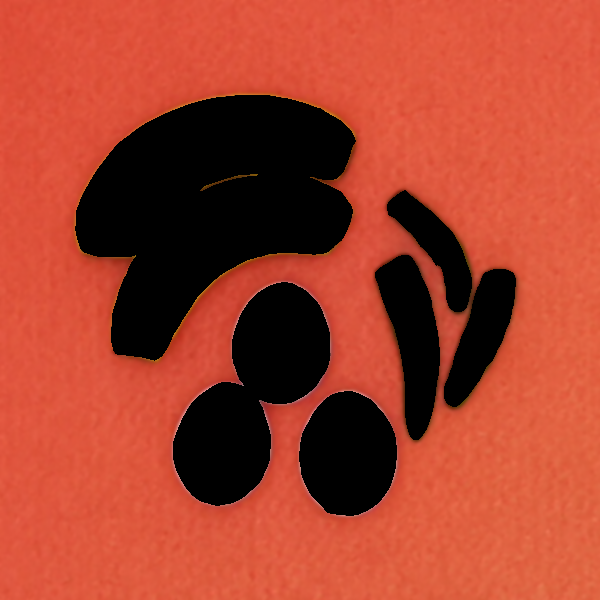

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento2_BG.png


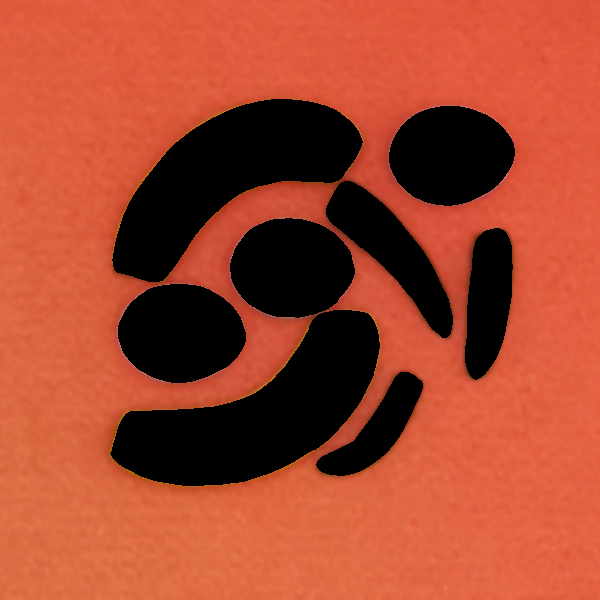

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento3_BG.png


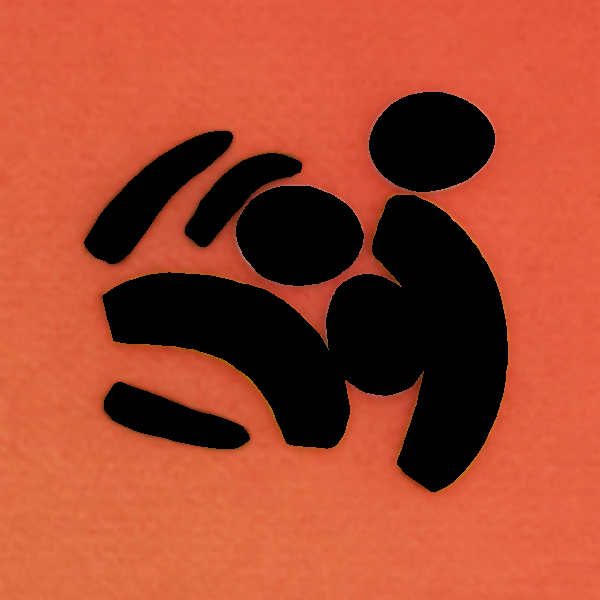

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento4_BG.png


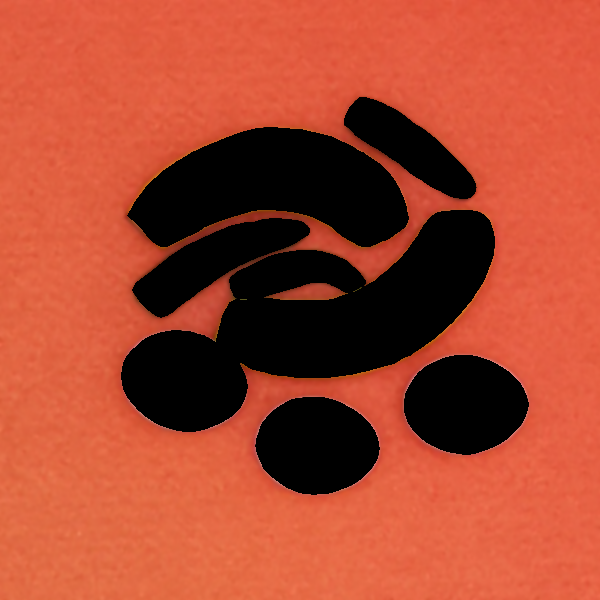

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento1_B.png


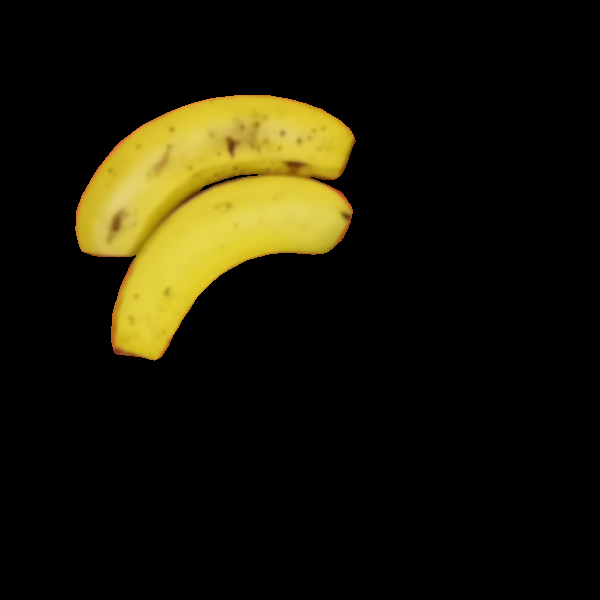

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento2_B.png


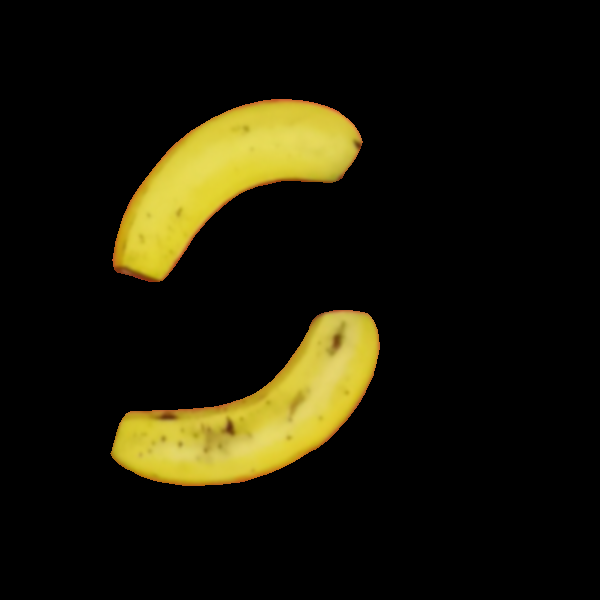

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento3_B.png


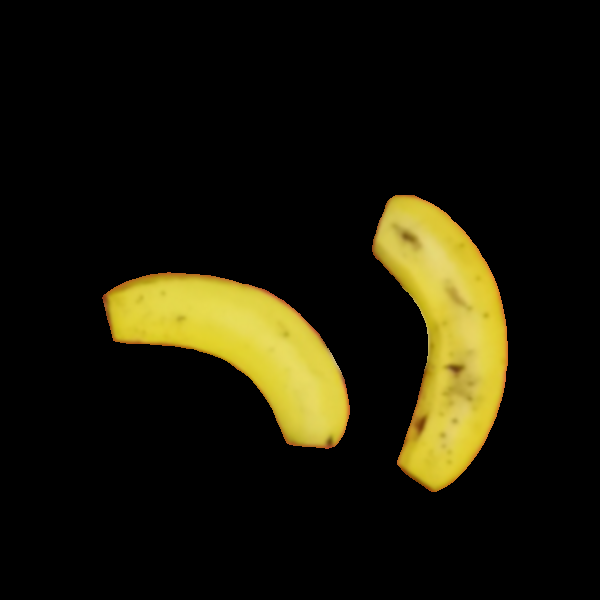

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento4_B.png


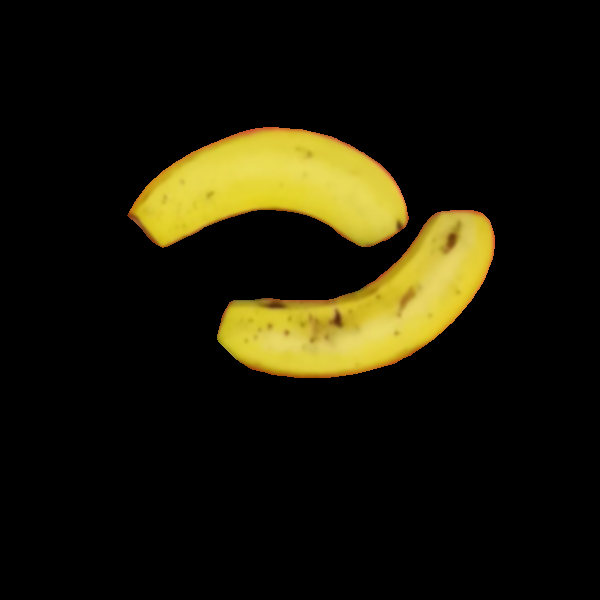

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento1_E.png


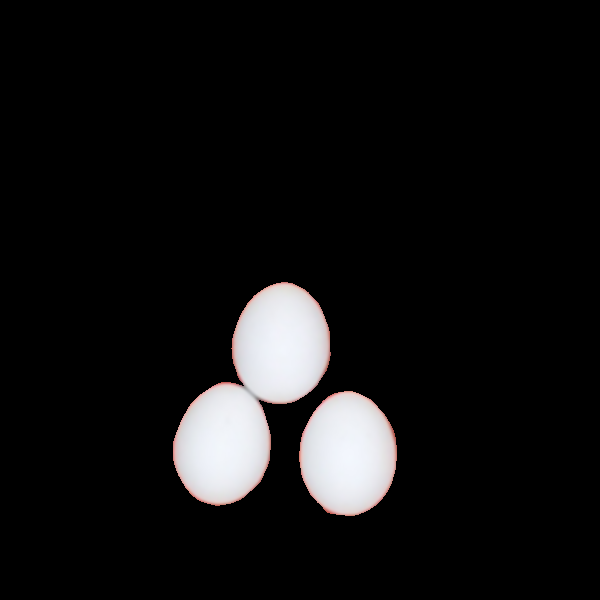

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento2_E.png


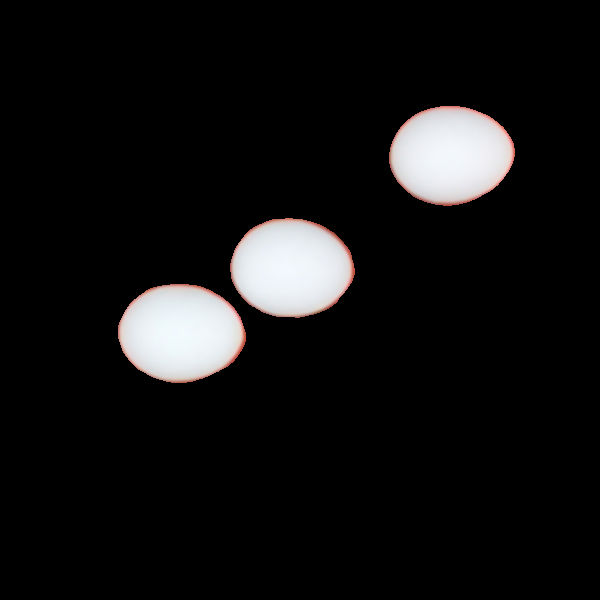

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento3_E.png


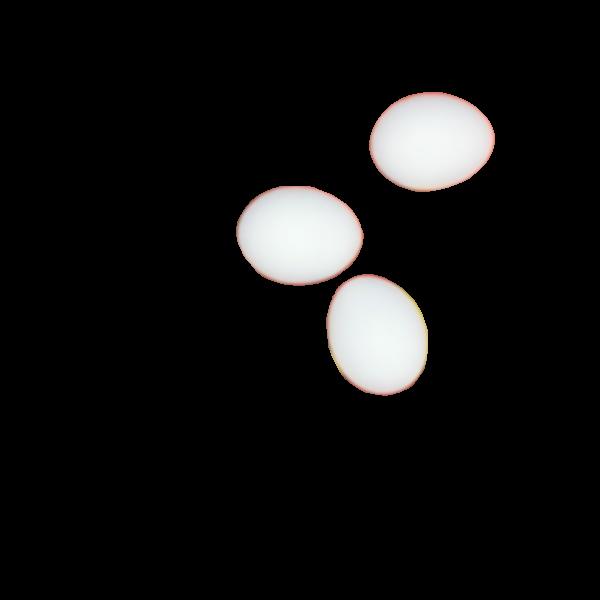

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento4_E.png


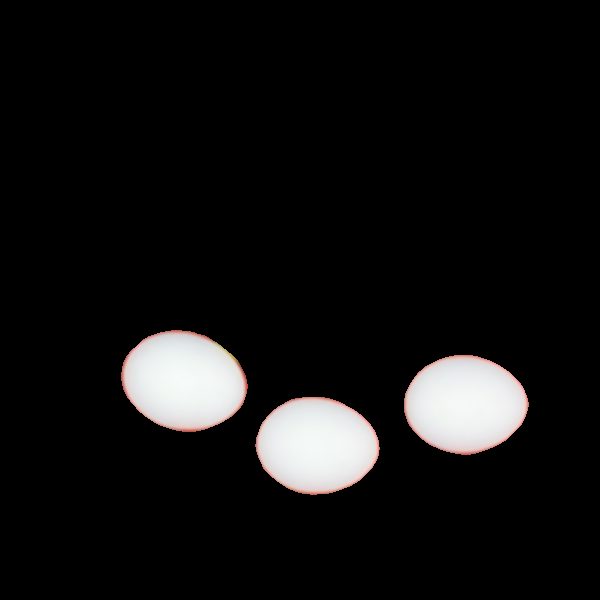

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento1_C.png


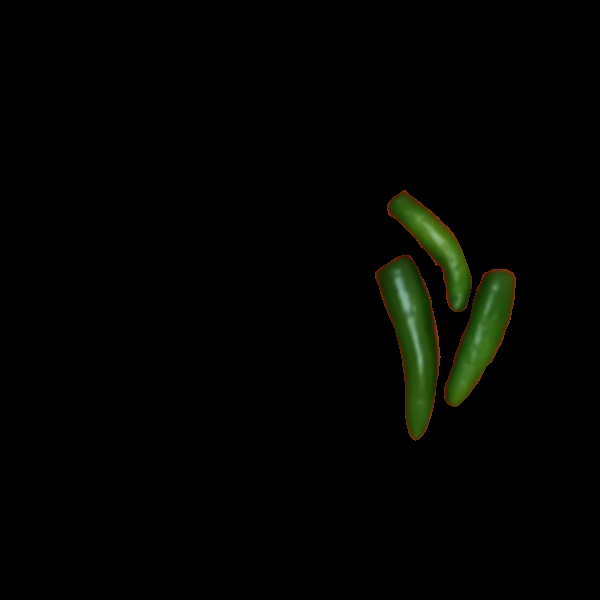

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento2_C.png


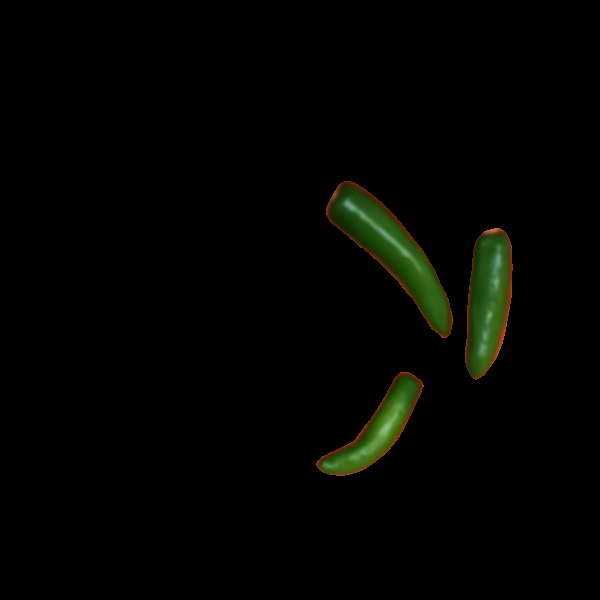

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento3_C.png


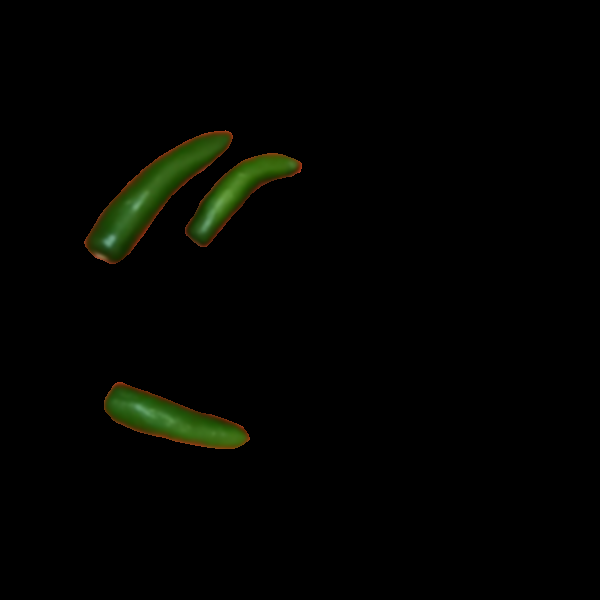

/content/PatternRecognition_2022-1/P02/Training/Food/Entrenamiento4_C.png


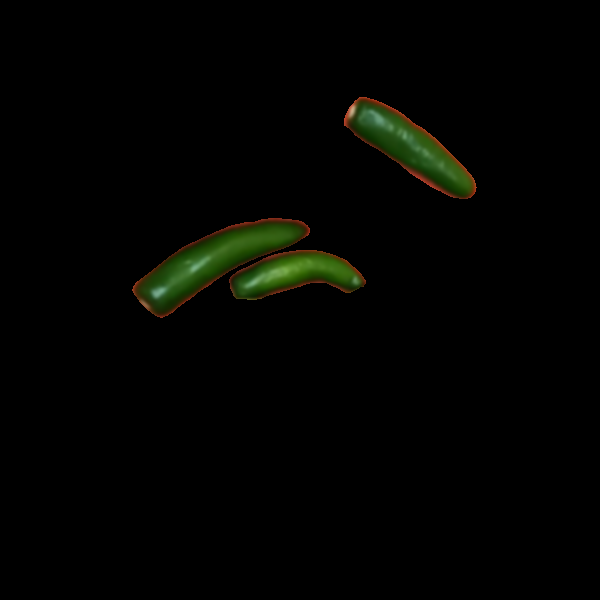

In [ ]:
# Background
trainList_Food_BG = glob.glob(trainPath_Food + '/*BG.png')
trainList_Food_BG.sort()
for image in trainList_Food_BG:
   print(image)
   img = cv2.imread(image)
   cv2_imshow(img)

# Bananas
trainList_Food_B = glob.glob(trainPath_Food + '/*B.png')
trainList_Food_B.sort()
for image in trainList_Food_B:
   print(image)
   img = cv2.imread(image)
   cv2_imshow(img)

# Eggs
trainList_Food_E = glob.glob(trainPath_Food + '/*E.png')
trainList_Food_E.sort()
for image in trainList_Food_E:
   print(image)
   img = cv2.imread(image)
   cv2_imshow(img)

# Chilies
trainList_Food_C = glob.glob(trainPath_Food + '/*C.png')
trainList_Food_C.sort()
for image in trainList_Food_C:
   print(image)
   img = cv2.imread(image)
   cv2_imshow(img)

In [ ]:
# Original images (no masking)
originalList_Food = glob.glob(trainPath_Food + 'Originals/*.jpg')
originalList_Food.sort()
for image in originalList_Food:
   print(image)
   img = cv2.imread(image)
   cv2_imshow(img)

In [ ]:
# Background
trainList_Monkeys_BG = glob.glob(trainPath_Monkeys + '/*BG.png')
trainList_Monkeys_BG.sort()
for image in trainList_Monkeys_BG:
   print(image)
   img = cv2.imread(image)
   cv2_imshow(img)

# Monkeys
trainList_Monkeys_M = glob.glob(trainPath_Monkeys + '/*M.png')
trainList_Monkeys_M.sort()
for image in trainList_Monkeys_M:
   print(image)
   img = cv2.imread(image)
   cv2_imshow(img)

/content/PatternRecognition_2022-1/P02/Training/Monkeys/Originals/n0020.jpg


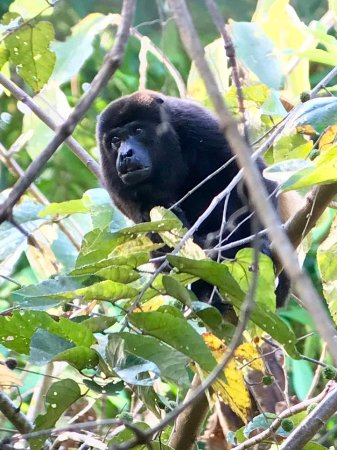

/content/PatternRecognition_2022-1/P02/Training/Monkeys/Originals/n0021.jpg


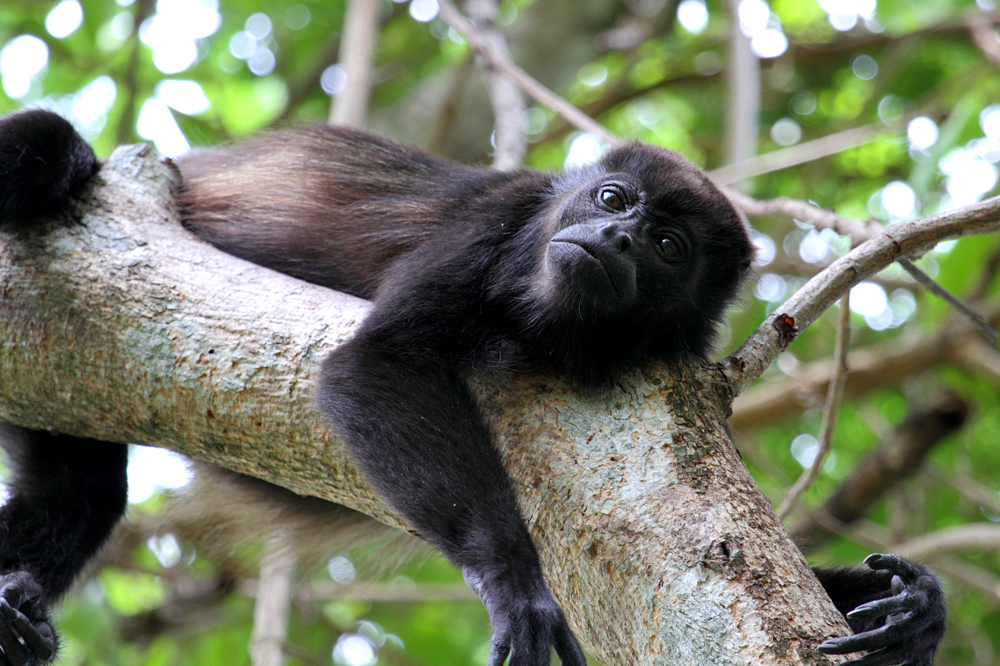

/content/PatternRecognition_2022-1/P02/Training/Monkeys/Originals/n0027.jpg


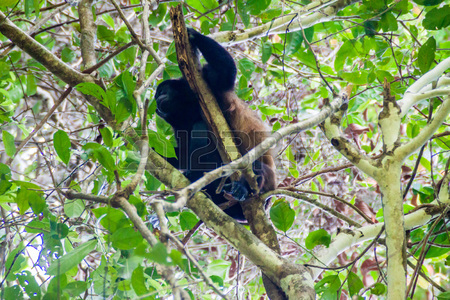

/content/PatternRecognition_2022-1/P02/Training/Monkeys/Originals/n0035.jpg


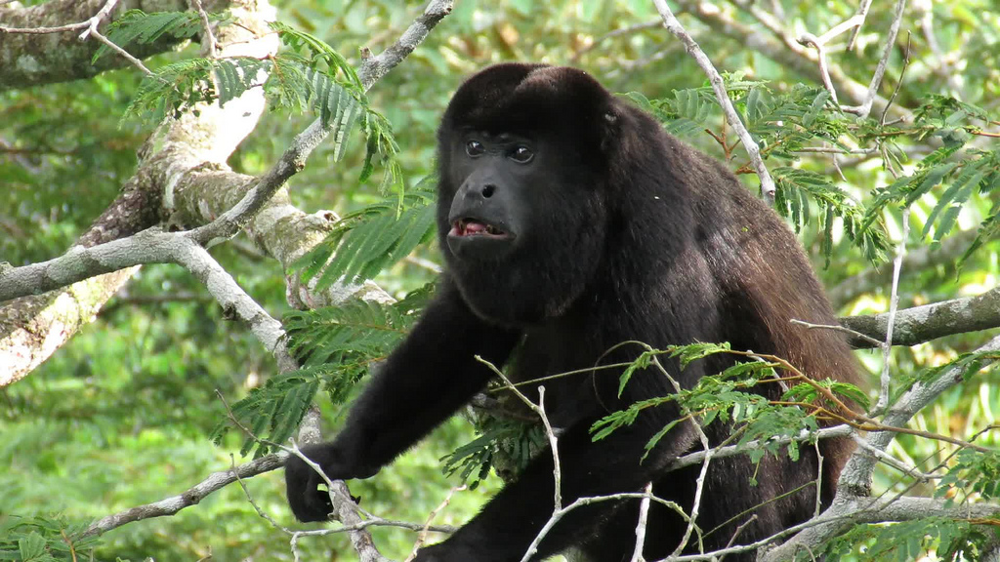

/content/PatternRecognition_2022-1/P02/Training/Monkeys/Originals/n019.jpg


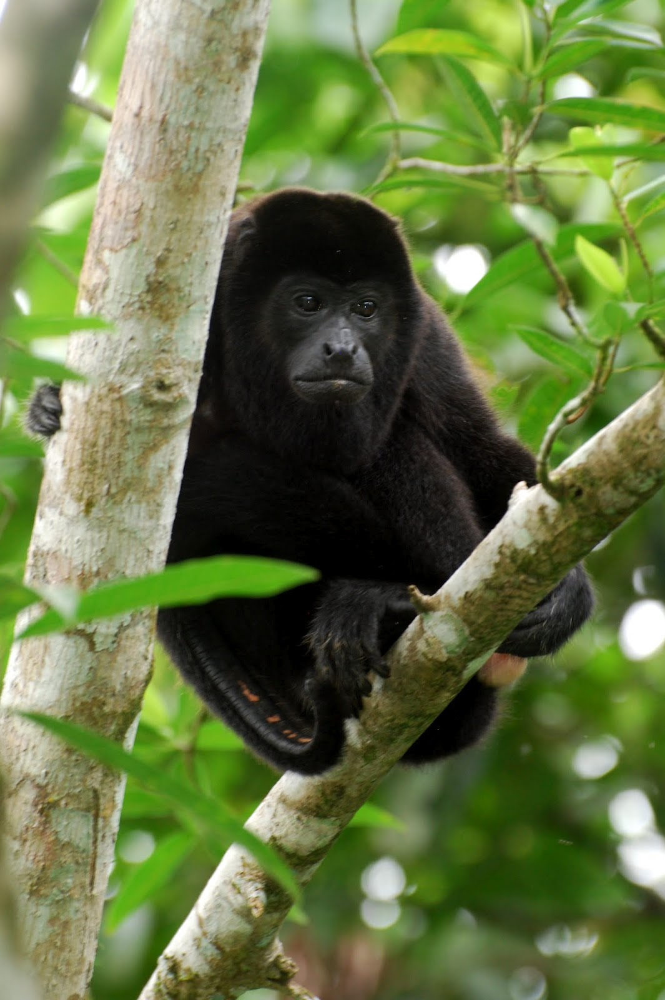

In [ ]:
# Original images (no masking)
originalList_Monkeys = glob.glob(trainPath_Monkeys + 'Originals/*.jpg')
originalList_Monkeys.sort()
for image in originalList_Monkeys:
   print(image)
   img = cv2.imread(image)
   cv2_imshow(img)

## 2. Mask processing
Se obtiene una máscara a partir de los píxeles negros de las imágenes procesadas anteriormente. Los 0s indican píxeles a descartar, los valores distintos a 0 indican la máscara.

In [ ]:
# Generates an array per mask; 0s mean the pixel is masked, values different than 0 mean the pixel will be processed
def getMask(imageList):

  maskList = list()
  for image in imageList: # For each image
    img = Image.open(image)
    imgR = np.asarray(img.split()[0]) # Takes R values
    imgG = np.asarray(img.split()[1]) # Takes G values
    imgB = np.asarray(img.split()[2]) # Takes B values
    imgMask = np.zeros_like(imgR) # Blank image for mask
    for i in range(0, len(imgR)): # For each column
      imgMask[i] = imgR[i] + imgG[i] + imgB[i] # Adds the R, G and B values per element
    maskList.append(imgMask)

  return maskList

In [ ]:
masks_Food_Background = getMask(trainList_Food_BG)
masks_Food_Bananas = getMask(trainList_Food_B)
masks_Food_Eggs = getMask(trainList_Food_E)
masks_Food_Chilies = getMask(trainList_Food_C)

In [ ]:
# Final value in pixels different than 0 is irrelevant, it will only serve to mark the indices of pixels to process in each region
masks_Food_Background[0][200]

array([103, 101, 101,  98, 101,  98, 100, 100, 101, 101, 103, 107, 109,
       108, 108, 108, 109, 111, 109, 106, 104, 102, 102, 104, 105, 108,
       110, 110, 109, 108, 108, 107, 104, 101, 100,  98,  95,  93,  92,
        92,  92,  92,  94,  96,  99, 103, 108, 110, 111, 108, 103,  97,
        94,  96, 102, 106, 111, 113, 116, 118, 119, 117, 113, 107, 100,
        97,  95,  94,  97,  98,  97,  95,  92,  88,  87,  83,  76,  69,
        70,  83,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   

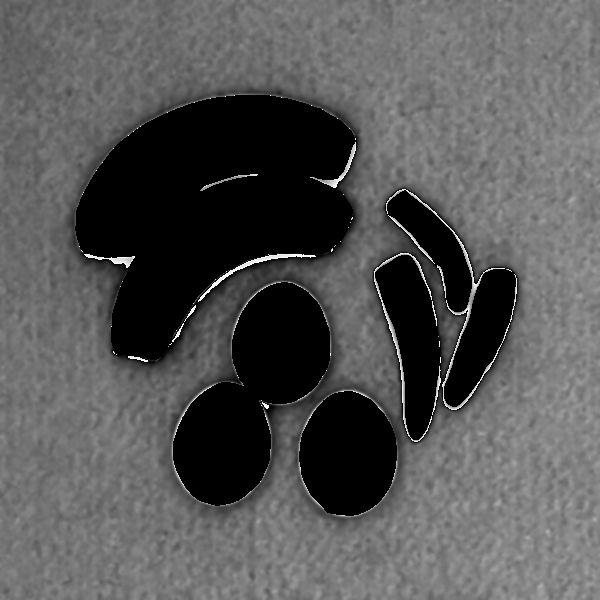

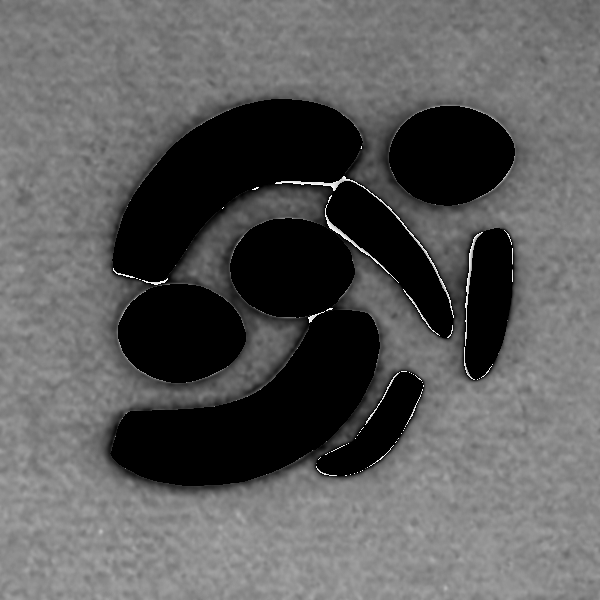

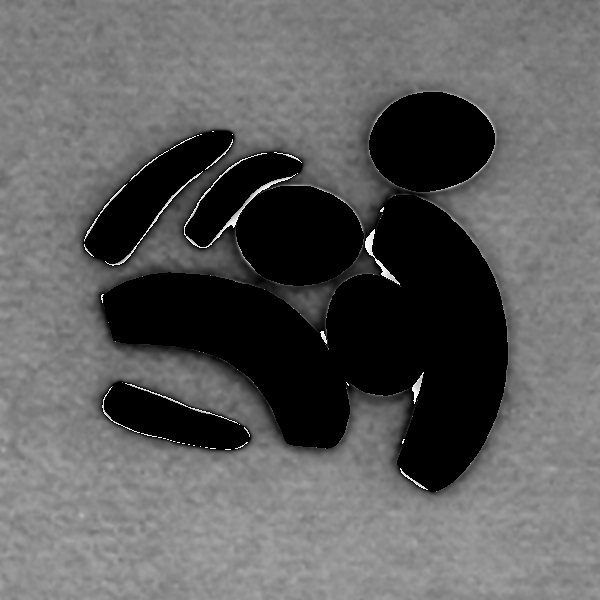

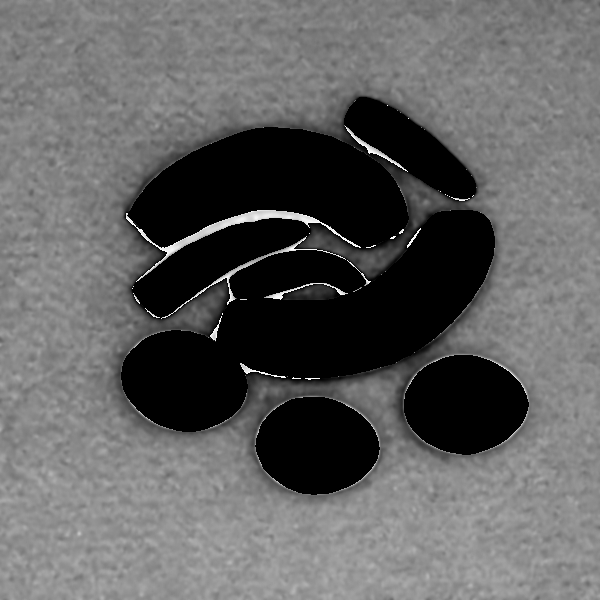

In [ ]:
for image in masks_Food_Background:
  imgPIL = Image.fromarray(np.uint8(image))
  display(imgPIL)
  print("\n")

In [ ]:
masks_Monkeys_Background = getMask(trainList_Monkeys_BG)
masks_Monkeys_Monkey = getMask(trainList_Monkeys_M)

In [ ]:
masks_Monkeys_Background[0][200]

array([201, 189, 168, 140, 106,  70,  38,  10, 238, 210, 179, 146, 110,
        75,  43,  23,  20,  35,  72, 129, 198,  13,  76, 123, 155, 175,
       183, 186, 183, 177, 171, 162, 150, 133, 114,  93,  71,  57,  50,
        55,  69,  92, 114, 131, 139, 130, 103,  61,  10, 215, 173, 145,
       130, 124, 121, 117, 112, 106, 102, 101, 102, 110, 117, 125, 129,
       131, 134, 140, 150, 165, 184, 198, 209, 213, 215, 215, 217, 223,
       233, 252,  22,  53,  85, 108, 122, 125, 125, 127, 133, 148, 164,
       179, 187, 191, 190, 188, 189, 186, 186, 185, 183, 179, 176, 172,
       167, 162, 156, 148, 136, 114,  79,  16,  54,  52,   1,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,  11,  48, 129, 194, 230, 24

In [ ]:
for image in masks_Monkeys_Background:
  imgPIL = Image.fromarray(np.uint8(image))
  display(imgPIL)
  print("\n")

## 2. Feature vector
Se obtiene el vector de características. Se utilizan las coordenadas de los píxeles así como sus valores RGB. Se obtienen las coordenadas a partir de los valores que no son cero de la máscara (mediante la función *nonzero* de NumPy, que devuelve un arreglo por dimensión, cada arreglo contiene el índice correspondiente de los valores diferentes de cero). A partir de esta información, se obtienen los valores RGB de los píxeles diferentes de cero. Finalmente, se concatenan las coordenadas y los valores RGB obtenidos, dando como resultado un arreglo de arreglos, siendo que cada arreglo son las características de un píxel.

In [ ]:
def featVector(images, masks):

  featVector = np.array([])
  tempComp = np.array([])

  for i in range (0, len(images)):
    image = np.asarray(Image.open(images[i]))
    mask = np.asarray(np.nonzero(masks[i])) # We get an array of indices of non-zero values, which we'll use to get appropiate pixels to get color from
    colours = image[mask[0], mask[1], :] # We get all colour values for the indicated range; mask[0] indicates column, mask[1] indicates row
    featArray = colours # One row per pixel, 3 features per row (r, g, b)
    if i == 0:
      featVector = featArray
    else:
      featVector = np.vstack((featVector, featArray)) # Add all rows from each image
  
  return featVector

In [ ]:
trainBackground_Food = featVector(originalList_Food, masks_Food_Background) # Feature vector
trainBananas_Food = featVector(originalList_Food, masks_Food_Bananas)
trainEggs_Food = featVector(originalList_Food, masks_Food_Eggs)
trainChilies_Food = featVector(originalList_Food, masks_Food_Chilies)

n_samples_Food = trainBackground_Food.shape[0] + trainBananas_Food.shape[0] + trainEggs_Food.shape[0] + trainChilies_Food.shape[0] # Shape is number of rows (events) and number of features

print(n_samples_Food) # Total of events
print(trainBackground_Food.shape[1]) # Total features

1439878
3


In [ ]:
trainBackground_Monkeys = featVector(originalList_Monkeys, masks_Monkeys_Background) # Feature vector
trainMonkey_Monkeys = featVector(originalList_Monkeys, masks_Monkeys_Monkey)

n_samples_Monkeys = trainBackground_Monkeys.shape[0] + trainMonkey_Monkeys.shape[0] # Shape is number of rows (events) and number of features

print(n_samples_Monkeys) # Total of events
print(trainBackground_Monkeys.shape[1]) # Total features

13789535
3


## 3. Covariance matrix and statistics
Se obtiene la matriz de covarianza y los estadísticos muestrales. En este caso, la media de cada característica, la matriz de covarianza, el determinante de la matriz y su inversa, y la probabilidad a priori de cada clase.

In [ ]:
def statistics(trainData, n_samples):

  mean = trainData.mean(axis = 0) # Mean of each feature
  sigma = np.cov(trainData.T) # Covariance matrix
  sigma_det = np.linalg.det(sigma) # Determinant of covariance matrix, to use on Bayes rule
  sigma_inv = np.linalg.inv(sigma) # Inverse of covariance matrix, to use on Bayes rule
  priori = trainData.shape[0] / n_samples # A priori probability, obtained dividing number of samples of a class by total number of samples

  print("Media:", mean, "\nMatriz de covarianza:", sigma, "\nDeterminante:", sigma_det, "\nMatriz de covarianza inversa:", sigma_inv, "Probabilidad a priori:", priori)

  return(mean, sigma_det, sigma_inv, priori)

## 4. Naive Bayes classifier
Se utiliza la fórmula para determinar la clase más probable a la que cada píxel de la entrada pertenece.
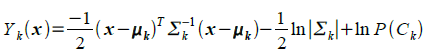

Para esto, se obtiene el vector de cada píxel de la imagen de entrada, se aplica la fórmula y, según el resultado de la clase más probable, a dicho píxel se le asignará un color específico.

In [ ]:
def obtainClass(classes, entry): # Dictionary with classes as keys and statistics as values, and data to classify

  probabilities = dict()

  for class_i, statistic in classes.items(): # For each class
    factor = 1/2 * np.log(statistic[1])
    exponential = -1/2 * np.dot((entry - statistic[0].T) @ statistic[2], entry - statistic[0])
    priori = np.log(statistic[3])
    probabilities[class_i] = exponential - factor + priori # Apply naive Bayes formula
  
  max_probability = max(probabilities, key = probabilities.get) # Get class with highest probability

  return max_probability

In [ ]:
# Dictionaries with colours for each class
colours_Food = {"Background":(210, 0, 0),"Banana":(230, 180, 0),"Egg":(230, 230, 200),"Chili":(100, 200, 0)}
colours_Monkeys = {"Background":(100, 200, 0), "Monkey":(30, 30, 30)}

In [ ]:
# Obtain regions identified by colours
def regions(classes, image, colours): # Receives classes dictionary, entry image and colours dictionary

  entryImg = np.asarray(image)
  shape = entryImg.shape[:2]
  shape = shape[::-1] # Fixes shape
  blankImg = Image.new('RGB', shape) # Creates new blank image with same shape as entry image
  arrayImg = np.array(blankImg) # Converts said image to array, for ease of use

  # For each pixel:
  for i in range(blankImg.size[1]):
    for j in range(blankImg.size[0]):
      featVector = np.array([entryImg[i, j, 0], entryImg[i, j, 1], entryImg[i, j, 2]]) # Creates feature vector with RGB values
      highClass = obtainClass(classes, featVector) # Obtains class with highest probability
      arrayImg[i, j] = np.array(colours[highClass]) # Puts respective colour on final image
    
  regions = Image.fromarray(arrayImg) # Converts array back to image

  return regions

In [ ]:
# Dictionaries of classes and their respective statistics
classes_Food = {"Background":statistics(trainBackground_Food, n_samples_Food),
                "Banana":statistics(trainBananas_Food, n_samples_Food),
                "Egg":statistics(trainEggs_Food, n_samples_Food),
                "Chili":statistics(trainChilies_Food, n_samples_Food)}

# Dictionaries of classes and their respective statistics
classes_Monkeys = {"Background":statistics(trainBackground_Monkeys, n_samples_Monkeys),
                   "Monkey":statistics(trainMonkey_Monkeys, n_samples_Monkeys)}

## 5. Test phase
Se realizan las pruebas con imágenes diferentes a las que se usaron para el entrenamiento.

In [ ]:
testPath_Food = "/content/PatternRecognition_2022-1/P02/Test/Food/"
testPath_Monkeys = "/content/PatternRecognition_2022-1/P02/Test/Monkeys/"

/content/PatternRecognition_2022-1/P02/Test/Food/Prueba1.jpg


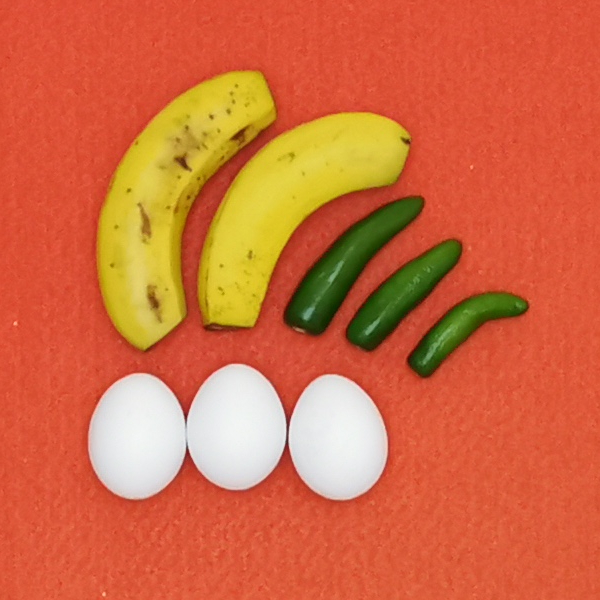

/content/PatternRecognition_2022-1/P02/Test/Food/Prueba2.jpg


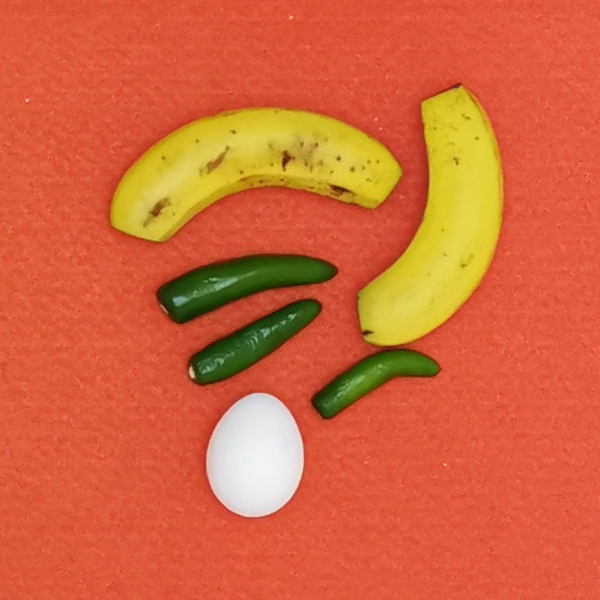

/content/PatternRecognition_2022-1/P02/Test/Food/Prueba3.jpg


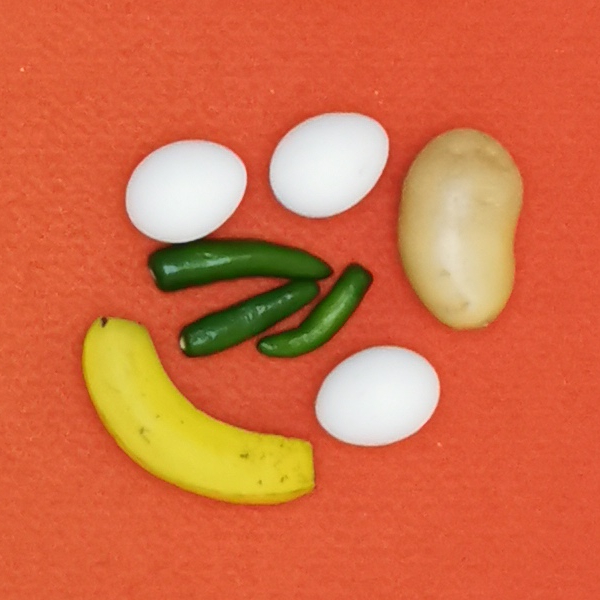

In [ ]:
testList_Food = glob.glob(testPath_Food + '/*.jpg')
testList_Food.sort()

for image in testList_Food:
   print(image)
   img = cv2.imread(image)
   cv2_imshow(img)

In [ ]:
testList_Monkeys = glob.glob(testPath_Monkeys + '/*.jpg')
testList_Monkeys.sort()

for image in testList_Monkeys:
   print(image)
   img = cv2.imread(image)
   cv2_imshow(img)

In [ ]:
results_Food = list()

for i in range(0, len(testList_Food)):
  currImage = Image.open(testList_Food[i])
  result = regions(classes_Food, currImage, colours_Food)
  results_Food.append(result)
  print("Imagen", i + 1, "procesada.")

Imagen 1 procesada.
Imagen 2 procesada.
Imagen 3 procesada.


In [ ]:
results_Monkeys = list()

for i in range(0, len(testList_Monkeys)):
  currImage = Image.open(testList_Monkeys[i])
  result = regions(classes_Monkeys, currImage, colours_Monkeys)
  results_Monkeys.append(result)
  print("Imagen", i + 1, "procesada.")

Imagen 1 procesada.
Imagen 2 procesada.
Imagen 3 procesada.
Imagen 4 procesada.
Imagen 5 procesada.


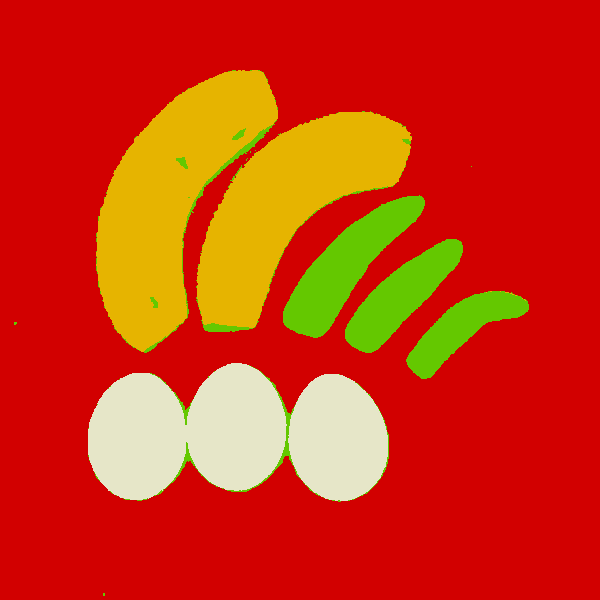

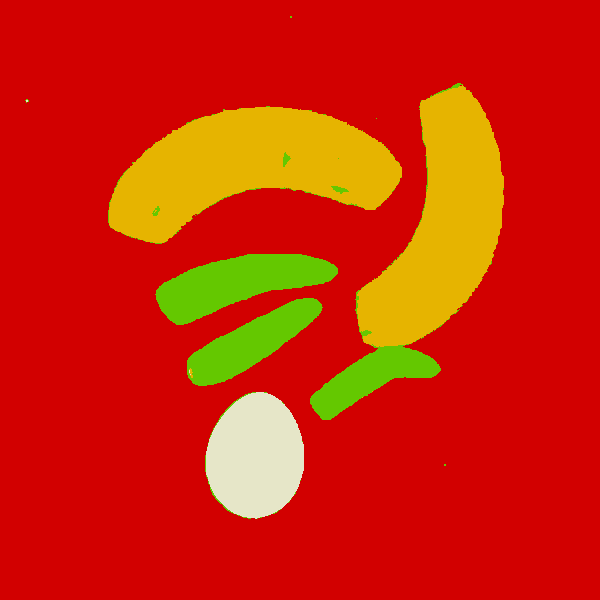

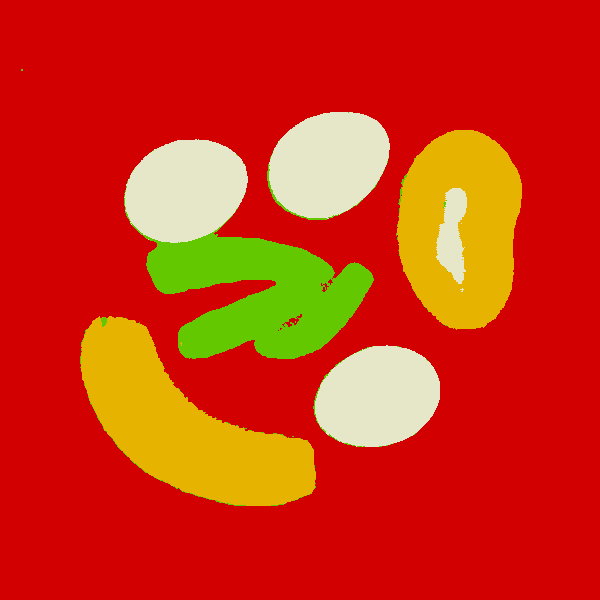

In [ ]:
for image in results_Food:
  display(image)
  print("\n")

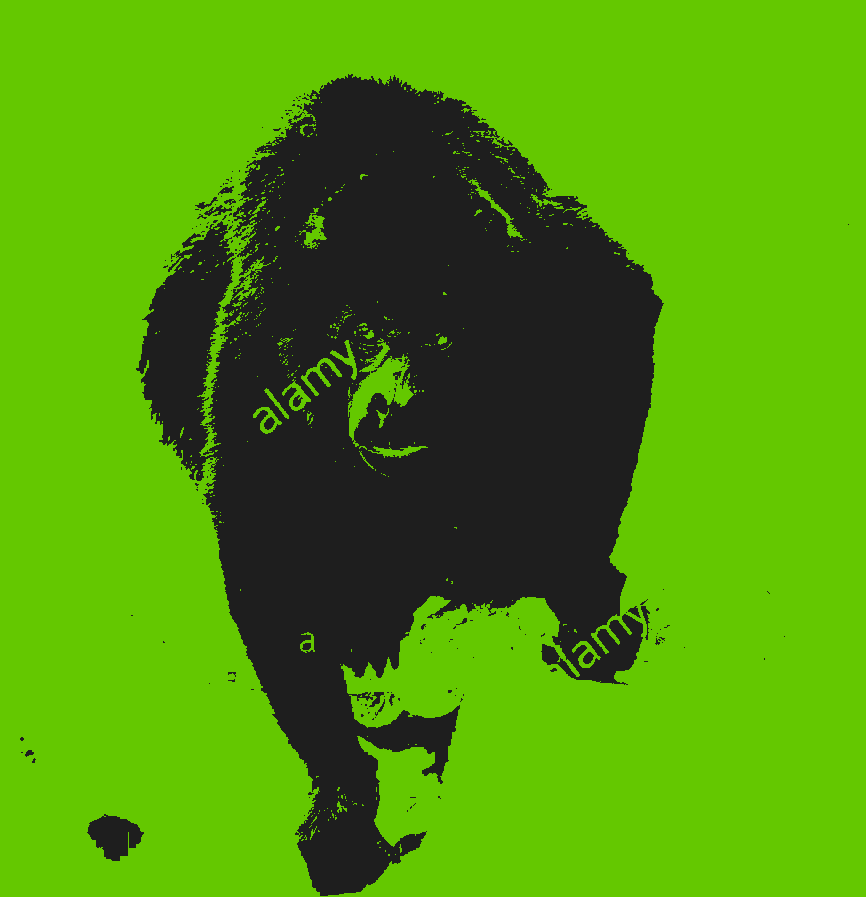

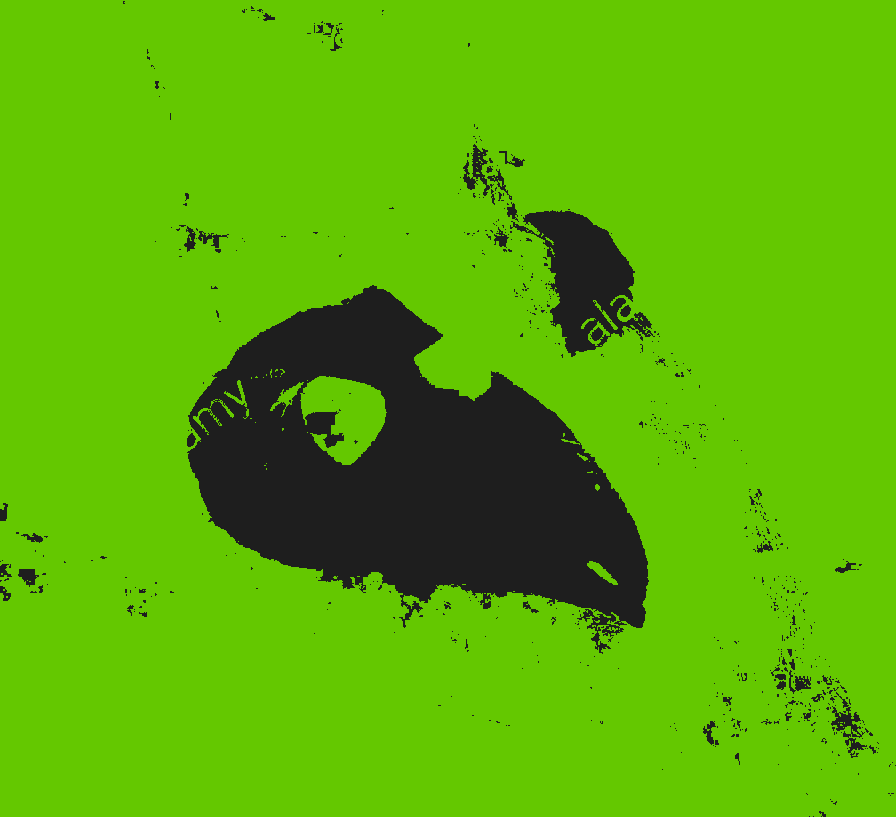

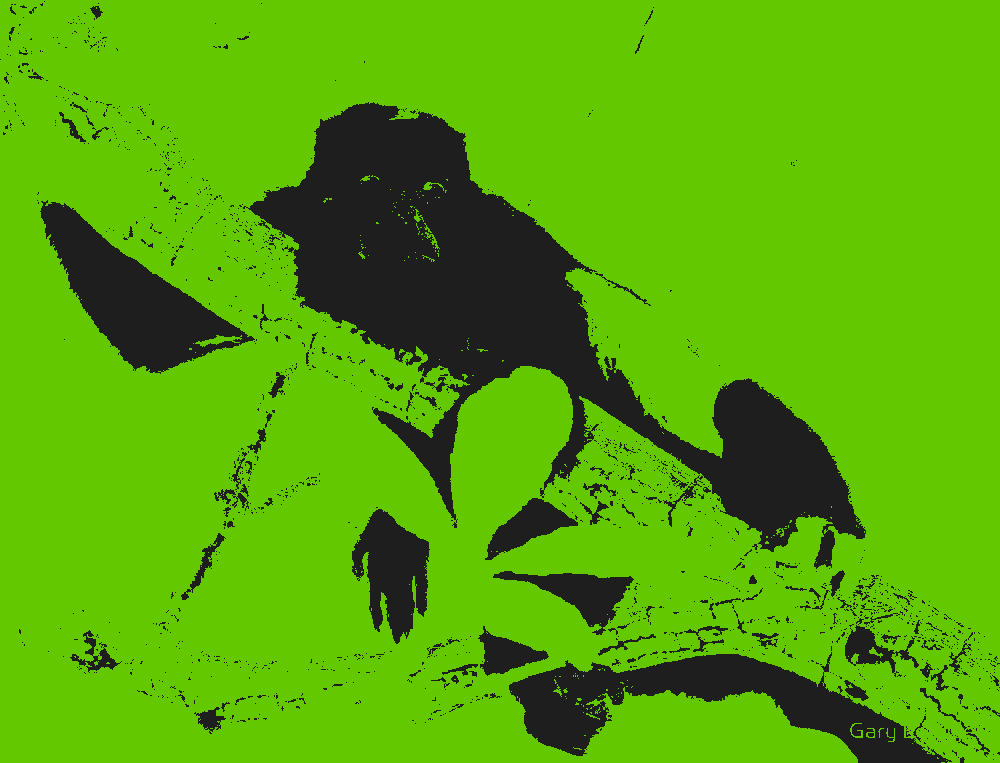

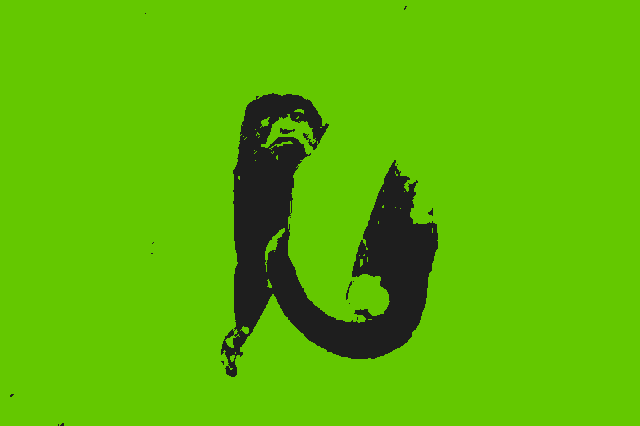

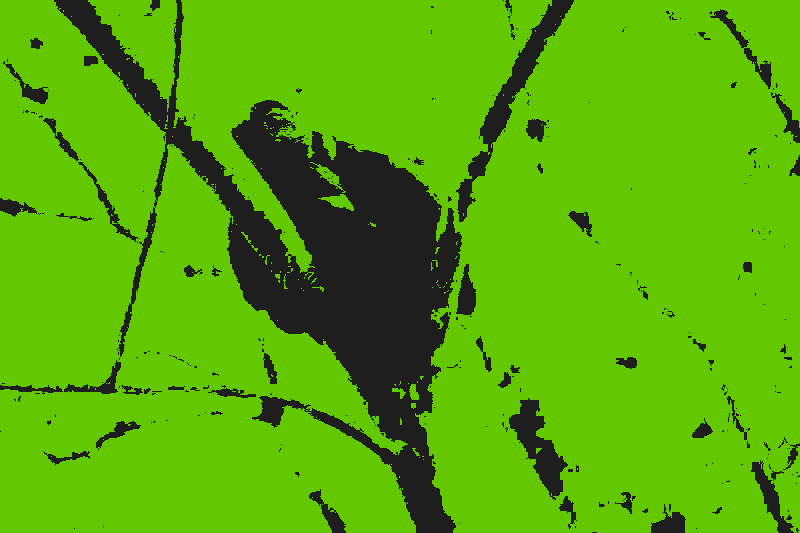

In [ ]:
for image in results_Monkeys:
  display(image)
  print("\n")